## Import dependencies 
MIT library needed for converting ABC music sheet to sound waves.

In [ ]:
# Import Tensorflow 2.0
%tensorflow_version 2.x
import tensorflow as tf 

# Download and import the MIT package
!pip install mitdeeplearning
import mitdeeplearning as mdl

# Import all remaining packages
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

# Check that we are using a GPU, if not switch runtimes
#   using Runtime > Change Runtime Type > GPU
assert len(tf.config.list_physical_devices('GPU')) > 0

     |████████████████████████████████| 2.1MB 9.0MB/s 
  Created wheel for mitdeeplearning: filename=mitdeeplearning-0.1.2-cp36-none-any.whl size=2114586 sha256=9543aa639d4f3472ede4a75208af6d852402580b8b32c277542a494250f4f334
  Stored in directory: /root/.cache/pip/wheels/27/e1/73/5f01c787621d8a3c857f59876c79e304b9b64db9ff5bd61b74
Successfully built mitdeeplearning


## Dataset

Dataset of Irish folk songs from MIT dataset. These songs have been represented in ABC notation.


In [ ]:
# Download the dataset
songs = mdl.lab1.load_training_data()

# Print one of the songs
selected_song = songs[0]
print("\nExample song: ")
print(selected_song)

Found 816 songs in text

Example song: 
X:2
T:An Buachaill Dreoite
Z: id:dc-hornpipe-2
M:C|
L:1/8
K:G Major
GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!
DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!
GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!
B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!


In [ ]:
songs

Converting ABC notation song to audio waveform using MIT Library. 

In [ ]:
selected_song = songs[1]
# Converting the ABC notation to audio file
mdl.lab1.play_song(selected_song)


The file contains information on the notes being played, as well as meta data such as the song title, key, and tempo. 

# Extrating only the notations

In [ ]:
to_delete = []
notes = []
import re


for i in range(0, len(songs)-1):
  
  x = songs[i]
  start = x.find('K:')
  end = len(x)
  note = x[start+2:end]
  if len(note) > 20:
    a,b = re.search('\n', note).span()
    end = len(note)
    note = note[b:end]
    note = re.sub('\n', '', note)
    #print(note)
    notes.append(note)
  else:
    to_delete.append(i)

header = x[0:start+2+b]
print (header)
notes = np.delete(notes, to_delete, axis = 0)
all_notes = ' '.join(notes)

# Unique notations
vocab = sorted(set(all_notes))
print(len(vocab))
print('\n',notes[2])



X:9
T:Spinning Wheel
Z: id:dc-waltz-11
M:3/4
L:1/8
K:G Major

57

 AG|F2FA GFD2|de (3fed d^cAF|G2GF GFDE|FdcA G2AG|!F2FA GFD2|de (3fed d^cAG|AdcA GcAG|F2D2 D2:|!fg|agfa gfeg|fd e^c d=cA2|agfa gfde|fdgf e2 fg|!a2ge f3e|d^cde fdAG|AdcA GcAG|F2D2 D2:|!


In [ ]:
songs_joined = all_notes
print(songs_joined)

GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|! ag|(3faf df AdFA|DFAd f2ef|gbec dfAF|GABG E2ag|!(3faf df AdFA|DFAd f2ef|gbed cABc|d2f2 d2:|!(3DEF|GFGA Bcde|fgfe dcdB|A2f2 fef2|G2e2 ede2|!GFGA Bcde|fgfe dcdB|Afed cABc|d2f2 d2:|!ag|(3fgf (3efe (3ded (3cdc|(3BcB (3ABA G2ba|(3gag (3fgf (3efe (3ded|(3cdc (3BcB A2ag|!(3fgf (3efe (3ded (3cdc|(3BcB (3ABA (3GAG (3FGF|Eged cABc|d2f2 d2:|! AG|F2FA GFD2|de (3fed d^cAF|G2GF GFDE|FdcA G2AG|!F2FA GFD2|de (3fed d^cAG|AdcA GcAG|F2D2 D2:|!fg|agfa gfeg|fd e^c d=cA2|agfa gfde|fdgf e2 fg|!a2ge f3e|d^cde fdAG|AdcA GcAG|F2D2 D2:|! ed|cAAB cBcd|eaaf gedB|c2Ac B2Bc|d2de dBGB|!AGAB cBcd|eaaf gedB|cAAc dBGB|BAAG A2:|!cd|eaab aged|eaab aged|egga gedB|egga gedB|!AGAB cBcd|eaaf gedB|cAAc dBGB|BAAG A2:|! ef|gfed edBd|edeg B2BA|G3A BABd|e2A2 A2ga|!bagf gfed|edeg B2BA|G3A BcBA|G2E2 E2:|!gf|e2B2 B2gf|eBBA B2gf|e3f gfga|b2e2 e2ga|!bagf gfed|e

In [ ]:
print(vocab)

[' ', '!', '"', "'", '(', ')', ',', '-', '/', '1', '2', '3', '4', '6', '8', '9', ':', '<', '=', '>', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'K', 'M', 'R', 'V', '[', ']', '^', '_', 'a', 'b', 'c', 'd', 'e', 'f', 'g', 'i', 'j', 'l', 'm', 'n', 'o', 'p', 'r', 's', 't', 'u', 'x', 'y', 'z', '|']


# Experiment can be done without removing meta data.

In [ ]:
"""
# Join our list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs) 
# Find all unique characters in the joined string
vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")
print(vocab)
"""


'\n# Join our list of song strings into a single string containing all songs\nsongs_joined = "\n\n".join(songs) \n# Find all unique characters in the joined string\nvocab = sorted(set(songs_joined))\nprint("There are", len(vocab), "unique characters in the dataset")\nprint(vocab)\n'

## Objective

Train an RNN model to learn patterns in the ABC music dataset. Generate (by prdiction) a new piece of music. 

Process - provie a character (s), predict the most probable next character 
RNNs maintains an internal state that depends on previously seen elements, so information about all characters seen up until a given moment will be taken into account in generating the prediction.

### Vectorize the text

Create a numerical representation of the text-based dataset. First maps unique characters to numbers, and then maps these numbers to characters in data containing all notes.

In [ ]:
### Define numerical representation of text ###
  
char2idx = {u:i for i, u in enumerate(vocab)}
idx2char = np.array(vocab)
print(char2idx)

{' ': 0, '!': 1, '"': 2, "'": 3, '(': 4, ')': 5, ',': 6, '-': 7, '/': 8, '1': 9, '2': 10, '3': 11, '4': 12, '6': 13, '8': 14, '9': 15, ':': 16, '<': 17, '=': 18, '>': 19, 'A': 20, 'B': 21, 'C': 22, 'D': 23, 'E': 24, 'F': 25, 'G': 26, 'K': 27, 'M': 28, 'R': 29, 'V': 30, '[': 31, ']': 32, '^': 33, '_': 34, 'a': 35, 'b': 36, 'c': 37, 'd': 38, 'e': 39, 'f': 40, 'g': 41, 'i': 42, 'j': 43, 'l': 44, 'm': 45, 'n': 46, 'o': 47, 'p': 48, 'r': 49, 's': 50, 't': 51, 'u': 52, 'x': 53, 'y': 54, 'z': 55, '|': 56}


In [ ]:
print('{')
for char,_ in zip(char2idx, range(10)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('  ...\n}')

{
  ' ' :   0,
  '!' :   1,
  '"' :   2,
  "'" :   3,
  '(' :   4,
  ')' :   5,
  ',' :   6,
  '-' :   7,
  '/' :   8,
  '1' :   9,
  ...
}


In [ ]:
### Vectorize the songs string ###

def vectorize_string(string):
  vectorized_output = np.array([char2idx[char] for char in string])
  return vectorized_output

# def vectorize_string(string):

vectorized_songs = vectorize_string(songs_joined)
vectorized_songs.shape
#print(songs_joined)
print(vectorized_songs)

[26 25 56 ... 16 56  1]


We can also look at how the first part of the text is mapped to an integer representation:

In [ ]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))
# check that vectorized_songs is a numpy array
assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"

'GF|DGGB d2' ---- characters mapped to int ----> [26 25 56 23 26 26 21  0 38 10]


### Create training examples and targets

For each input, the corresponding target should be the next character to the right.

We'll break the text into chunks of `seq_length+1` defining how many notations we want to take as one set. Suppose `seq_length` is 4 and our text is "Hello". Then, our input sequence is "Hell" and the target sequence is "ello".


In [ ]:
### Batch definition to create training examples ###

def get_batch(vectorized_songs, seq_length, batch_size):
  # the length of the vectorized songs string
  n = vectorized_songs.shape[0] - 1
  # randomly choose the starting indices for the examples in the training batch
  idx = np.random.choice(n-seq_length, batch_size)
  input_batch = [vectorized_songs[i : i+seq_length] for i in idx]
  output_batch = [vectorized_songs[i+1 : i+seq_length+1] for i in idx]

  # x_batch, y_batch provide the true inputs and targets for network training
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch



In [ ]:
"""
# Perform some simple tests to make sure your batch function is working properly! 
test_args = (vectorized_songs, seq_length, batch_size)
if not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args): 
   print("======\n[FAIL] could not pass tests")
else: 
   print("======\n[PASS] passed all tests!")
"""

'\n# Perform some simple tests to make sure your batch function is working properly! \ntest_args = (vectorized_songs, seq_length, batch_size)\nif not mdl.lab1.test_batch_func_types(get_batch, test_args) or    not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or    not mdl.lab1.test_batch_func_next_step(get_batch, test_args): \n   print("======\n[FAIL] could not pass tests")\nelse: \n   print("======\n[PASS] passed all tests!")\n'

In [ ]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)
print (x_batch)
print (y_batch)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

[[39  0 41 35 41]]
[[ 0 41 35 41 39]]
Step   0
  input: 39 ('e')
  expected output: 0 (' ')
Step   1
  input: 0 (' ')
  expected output: 41 ('g')
Step   2
  input: 41 ('g')
  expected output: 35 ('a')
Step   3
  input: 35 ('a')
  expected output: 41 ('g')
Step   4
  input: 41 ('g')
  expected output: 39 ('e')


## The Recurrent Neural Network (RNN) model

Now we're ready to define and train a RNN model on our ABC music dataset, and then use that trained model to generate a new song. We'll train our RNN using batches of song snippets from our dataset, which we generated in the previous section.

The model is based off the LSTM architecture, where we use a state vector to maintain information about the temporal relationships between consecutive characters. The final output of the LSTM is then fed into a fully connected [`Dense`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dense) layer where we'll output a softmax over each character in the vocabulary, and then sample from this distribution to predict the next character. 

As we introduced in the first portion of this lab, we'll be using the Keras API, specifically, [`tf.keras.Sequential`](https://www.tensorflow.org/api_docs/python/tf/keras/models/Sequential), to define the model. Three layers are used to define the model:

* [`tf.keras.layers.Embedding`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Embedding): This is the input layer, consisting of a trainable lookup table that maps the numbers of each character to a vector with `embedding_dim` dimensions.
* [`tf.keras.layers.LSTM`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/LSTM): Our LSTM network, with size `units=rnn_units`. 
* [`tf.keras.layers.Dense`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dense): The output layer, with `vocab_size` outputs.


<img src="https://raw.githubusercontent.com/aamini/introtodeeplearning/2019/lab1/img/lstm_unrolled-01-01.png" alt="Drawing"/>

### Define the RNN model

Now, we will define a function that we will use to actually build the model.

In [ ]:
def LSTM(rnn_units): 
  return tf.keras.layers.LSTM(
    rnn_units, 
    return_sequences=True, 
    recurrent_initializer='glorot_uniform',
    recurrent_activation='sigmoid',
    stateful=True,
  )

In [ ]:
### Defining the RNN Model ###

def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    # Layer 1: Embedding layer to transform indices into dense vectors 
    #   of a fixed embedding size
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),

    # Layer 2: LSTM with `rnn_units` number of units. 
    LSTM(rnn_units), 
    # LSTM('''TODO'''),

    # Layer 3: Dense (fully-connected) layer that transforms the LSTM output
    #   into the vocabulary size. 
    tf.keras.layers.Dense(vocab_size)
  ])

  return model

model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

### Test out the RNN model


In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (32, None, 256)           14592     
_________________________________________________________________
lstm (LSTM)                  (32, None, 1024)          5246976   
_________________________________________________________________
dense (Dense)                (32, None, 57)            58425     
Total params: 5,319,993
Trainable params: 5,319,993
Non-trainable params: 0
_________________________________________________________________


## Training the model: loss and training operations

At this point, we can think of our next character prediction problem as a standard classification problem. Given the previous state of the RNN, as well as the input at a given time step, we want to predict the class of the next character -- that is, to actually predict the next character. 

To train our model on this classification task, we can use a form of the `crossentropy` loss (negative log likelihood loss). Specifically, we will use the [`sparse_categorical_crossentropy`](https://www.tensorflow.org/api_docs/python/tf/keras/backend/sparse_categorical_crossentropy) loss, as it utilizes integer targets for categorical classification tasks. We will want to compute the loss using the true targets -- the `labels` -- and the predicted targets -- the `logits`.

Let's first compute the loss using our example predictions from the untrained model: 

In [ ]:
### Defining the loss function ###

def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
  return loss


## Hyperparameter setting
Let's start by defining some hyperparameters for training the model. To start, we have provided some reasonable values for some of the parameters. It is up to you to use what we've learned in class to help optimize the parameter selection here!

In [ ]:
### Hyperparameter setting and optimization ###

# Optimization parameters:
num_training_iterations = 2000  # Increase this to train longer
batch_size = 32  # Experiment between 1 and 64
seq_length = 10  # Experiment between 50 and 500
learning_rate = 5e-3  # Experiment between 1e-5 and 1e-1

# Model parameters: 
vocab_size = len(vocab)
embedding_dim = 256 
rnn_units = 1024  # Experiment between 1 and 2048

# Checkpoint location: 
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

Now, we are ready to define our training operation -- the optimizer and duration of training -- and use this function to train the model. You will experiment with the choice of optimizer and the duration for which you train your models, and see how these changes affect the network's output. Some optimizers you may like to try are [`Adam`](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/Adam?version=stable) and [`Adagrad`](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/Adagrad?version=stable).

First, we will instantiate a new model and an optimizer. Then, we will use the [`tf.GradientTape`](https://www.tensorflow.org/api_docs/python/tf/GradientTape) method to perform the backpropagation operations. 

We will also generate a print-out of the model's progress through training, which will help us easily visualize whether or not we are minimizing the loss.

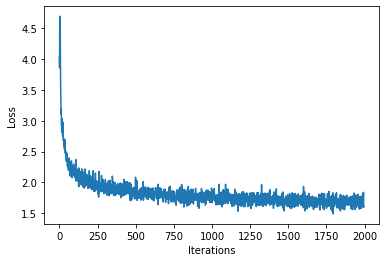

100%|██████████| 2000/2000 [00:25<00:00, 79.44it/s] 

1.768611


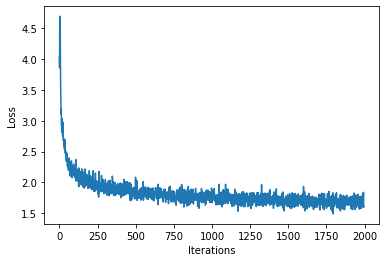

In [ ]:
### Define optimizer and training operation ###

model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)
optimizer = tf.keras.optimizers.Adam(learning_rate)

@tf.function
def train_step(x, y): 
  # Use tf.GradientTape()
  with tf.GradientTape() as tape:
    # Generate prediction and compute loss
    y_hat = model(x)
    loss = compute_loss(y, y_hat)

  # Now, compute the gradients 
  grads = tape.gradient(loss, model.trainable_variables)
  
  # Apply the gradients to the optimizer so it can update the model accordingly
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss

# Training

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists

for iter in tqdm(range(num_training_iterations)):

  # Grab a batch and propagate it through the network
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  # Update the progress bar
  history.append(loss.numpy().mean())
  plotter.plot(history)

  # Update the model with the changed weights!
  if iter % 100 == 0:     
    model.save_weights(checkpoint_prefix)
    
# Save the trained model and the weights
model.save_weights(checkpoint_prefix)
print(loss.numpy().mean())

## 2.6 Generate music using the RNN model

Now, we can use our trained RNN model to generate some music! When generating music, we'll have to feed the model some sort of seed to get it started because it can't predict anything without something to start with.

Once we have a generated seed, we can then iteratively predict each successive character using the trained RNN. 

### Restore the latest checkpoint

To keep this inference step simple, we will use a batch size of 1. Because of how the RNN state is passed from timestep to timestep, the model will only be able to accept a fixed batch size once it is built. 

To run the model with a different `batch_size`, we'll need to rebuild the model and restore the weights from the latest checkpoint, i.e., the weights after the last checkpoint during training:

In [ ]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

# Restore the model weights for the last checkpoint after training
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (1, None, 256)            14592     
_________________________________________________________________
lstm_2 (LSTM)                (1, None, 1024)           5246976   
_________________________________________________________________
dense_2 (Dense)              (1, None, 57)             58425     
Total params: 5,319,993
Trainable params: 5,319,993
Non-trainable params: 0
_________________________________________________________________


Notice that we have fed in a fixed `batch_size` of 1 for inference.

### The prediction procedure

Now, we're ready to write the code to generate text in the ABC music format:

* Initialize a "seed" start string and the RNN state, and set the number of characters we want to generate.

* Use the start string and the RNN state to obtain the probability distribution over the next predicted character.

* Sample from multinomial distribution to calculate the index of the predicted character. This predicted character is then used as the next input to the model.

* At each time step, the updated RNN state is fed back into the model, so that it now has more context in making the next prediction. After predicting the next character, the updated RNN states are again fed back into the model, which is how it learns sequence dependencies in the data, as it gets more information from the previous predictions.

![LSTM inference](https://raw.githubusercontent.com/aamini/introtodeeplearning/2019/lab1/img/lstm_inference.png)

Complete and experiment with this code block (as well as some of the aspects of network definition and training!), and see how the model performs. How do songs generated after training with a small number of epochs compare to those generated after a longer duration of training?

In [ ]:
### Prediction of a generated song ###

def generate_text(model, start_string, generation_length=1000):
  input_eval = [char2idx[s] for s in start_string] # TODO
  input_eval = tf.expand_dims(input_eval, 0)
  text_generated = []

  # Here batch size == 1
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      predictions = model(input_eval)
      
      # Remove the batch dimension
      predictions = tf.squeeze(predictions, 0)
      
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
      # Pass the prediction along with the previous hidden state
      #   as the next inputs to the model
      input_eval = tf.expand_dims([predicted_id], 0)
      text_generated.append(idx2char[predicted_id])
    
  return (start_string + ''.join(text_generated))

In [ ]:
def get_header(sondID):
  x = songs[sondID]
  start = x.find('K:')
  end = len(x)
  note = x[start+2:end]

  if len(note) > 20:
    a,b = re.search('\n', note).span()

  header = x[0:start+b+1]
  return header

In [ ]:
'''Use the model and the function defined above to generate ABC format text of length 500/1000
    As you may notice, ABC files start with "X" - this may be a good start string.'''
song = generate_text(model, start_string="F", generation_length=500)
print('\n',song)
song = song.replace('\n','')
i = 0
line = ''

while i < len(song):
  break_point = np.random.randint(30,45)
  new_line = song[i:i+break_point].strip()
  line = line + '\n' + new_line
  i = i + break_point
#print(line)

#song = '\n'.join([song[i:i+np.random.randint(30,45)+1] for i in range(0, len(song), 25)])
#song = song.replace('n\ ','\n')
#beginning =  song[0:10]
#rest = song[10:]
#beginning = beginning.replace(' ','')
new_song = get_header(np.random.randint(0,len(notes))) + line


100%|██████████| 500/500 [00:02<00:00, 219.46it/s]


 FDD2|G2 EGAB|c3A Bdd|d^ce a3|eaa age|dBG GABG|!cGfg|aAA2 FAB|cBcA BdcB AGEG|F2d def|g3dBGB gdBGA|B2dB AGE|Fdf ecA|ece dB|AFEF DEFG|e|fd dgba|cd ec a3g|aba gedB|BD D2 FA|DAAFG|cBA Bd|g3 f3|e3 ede|g3e|fa|eaa ece|ABd agag|fadf ec B3A|BcBA ecc2|BcBc2E2 F2D2:|!FBG E2D2:|!Adde fefe|dedAGF D2:|!B|AEBEE|!GBA A2c|!d2BG Bcd|ecc2 eage fdged|egfg|egecd|Bege fecd|e2a age|g3 gfg|edB|deg age|ea ecBA|!Dga|bagf|g2fg agfg|afge dBd|ecA cBcB|BABc A2c|![1 f/e/|B|AGF G2:|! cBA|a|fdd edBd|g3 fcd|ecA BGcA|B3 GEe|e2c Ad|


In [ ]:
print(new_song)

X:268
T:Old Bush
Z: id:dc-reel-248
M:C
L:1/8
K:D Mixolydian
FDD2|G2 EGAB|c3A Bdd|d^ce a3|eaa age|dBG
GABG|!cGfg|aAA2 FAB|cBcA BdcB AGEG|F2d
def|g3dBGB gdBGA|B2dB AGE|Fdf ecA|ece dB
|AFEF DEFG|e|fd dgba|cd ec a3g|aba ge
dB|BD D2 FA|DAAFG|cBA Bd|g3 f3|e3 ed
e|g3e|fa|eaa ece|ABd agag|fadf ec B3A|
BcBA ecc2|BcBc2E2 F2D2:|!FBG E2D2:|!Adde fe
fe|dedAGF D2:|!B|AEBEE|!GBA A2c|!d2BG Bcd
|ecc2 eage fdged|egfg|egecd|Bege fe
cd|e2a age|g3 gfg|edB|deg age|ea ec
BA|!Dga|bagf|g2fg agfg|afge dBd
|ecA cBcB|BABc A2c|![1 f/e/|B|AGF G2
:|! cBA|a|fdd edBd|g3 fcd|ecA
BGcA|B3 GEe|e2c Ad|


### Play back the generated music!

We can now call a function to convert the ABC format text to an audio file, and then play that back to check out our generated music! Try training longer if the resulting song is not long enough, or re-generating the song!

In [ ]:
import pandas as pd
import io
text = open('text.txt','w')
text.write(str(new_song))
text.close()
text = open('/content/text.txt','r')
print(text.read())

X:268
T:Old Bush
Z: id:dc-reel-248
M:C
L:1/8
K:D Mixolydian
FDD2|G2 EGAB|c3A Bdd|d^ce a3|eaa age|dBG
GABG|!cGfg|aAA2 FAB|cBcA BdcB AGEG|F2d
def|g3dBGB gdBGA|B2dB AGE|Fdf ecA|ece dB
|AFEF DEFG|e|fd dgba|cd ec a3g|aba ge
dB|BD D2 FA|DAAFG|cBA Bd|g3 f3|e3 ed
e|g3e|fa|eaa ece|ABd agag|fadf ec B3A|
BcBA ecc2|BcBc2E2 F2D2:|!FBG E2D2:|!Adde fe
fe|dedAGF D2:|!B|AEBEE|!GBA A2c|!d2BG Bcd
|ecc2 eage fdged|egfg|egecd|Bege fe
cd|e2a age|g3 gfg|edB|deg age|ea ec
BA|!Dga|bagf|g2fg agfg|afge dBd
|ecA cBcB|BABc A2c|![1 f/e/|B|AGF G2
:|! cBA|a|fdd edBd|g3 fcd|ecA
BGcA|B3 GEe|e2c Ad|


In [ ]:
# Convert the ABC notation to audio file and listen to it
mdl.lab1.play_song(new_song)